# Assignment Information

- Assignment: Homework 8
- Author: Charles Hoyt
- Due: June 24, 2016
- Language: R
- Posted: https://github.com/cthoyt/notebooks/blob/master/bit/abi/AbiHomework8.ipynb

In [1]:
source("https://bioconductor.org/biocLite.R")

Bioconductor version 3.3 (BiocInstaller 1.22.2), ?biocLite for help


# Assignment 7 Exercise 2

Gaussian mixture models (GMM)

## Assignment 7 Exercise 2A

a) A GMM can be described as

$p(x) = \sum_{k=1}^K\pi_k \times N(x\mid \mu_k, \Sigma_k) \text{with} \sum_{k=1}^K\pi_k=1, \pi_k\in[0,1]$

Assuming we like to cluster patients in one of two categories on the basis of expressions from 25 genes. The complexity of the model can be controlled by restricting how the covariance matrices $\Sigma_k$ are allowed to vary.

Reference: https://core.ac.uk/download/files/153/6303216.pdf

### Assignment 7 Exercise 2Ai

How many parameters (degrees of freedom) does the most general model possess, i.e., with no restrictions posed on the covariances?

> The most general model `VVV` takes the form of $\lambda_kD_kA_kD_k^T$ where $D_k$ describes the orientation of the $kth$ component, $A_k$ is the shape, and $\lambda_k$ is the volume. This model has $G\frac{d(d+1)}{2}$ parameters where $G$ is the number of components (gaussians) and $d$ is the dimension of the data.

### Assignment 7 Exercise 2Aii

Assuming that all normal distributions are ‘diagonal’, i.e., there is no correlation between the expression of different genes for each Gaussian ( is a diagonal matrix), how many parameters does this model possess?

> The type `EII` model uses 1 parameter, $\lambda$, for the covariance matrix, which takes the form of $\lambda I$.

### Assignment 7 Exercise 2Aiii

Like ii) assume no correlation but additionally the variation for each gene is the same for each Gaussian, i.e., the Gaussians are spherical. How many parameters does this model possess?
(3 points + 1 bonus point)

> The type `VII` covariance matrix is a diagonal matrix with varying entries that takes the form of $\lambda_kI$ and has $K$ parameters where $K$ is the number of gaussians.

## Installations

Now install the R-package [mclust](https://cran.r-project.org/web/packages/mclust/index.html) and get familiar with its functionality. The model based clustering Mclust will apply different GMM models depending on the restrictions on the covariance matrices . (For the models of a) the abbreviations used in mclust are i) VVV, ii) VVI, and iii) VII.) An optimal model is then selected based on the BIC.

In [2]:
#biocLite('mclust')

In [3]:
#biocLite("colonCA")

In [4]:
library(cluster)

In [5]:
library(mclust)
library(colonCA)
data(colonCA)

Package 'mclust' version 5.2
Type 'citation("mclust")' for citing this R package in publications.
Loading required package: Biobase
Loading required package: BiocGenerics
Loading required package: parallel

Attaching package: ‘BiocGenerics’

The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB

The following objects are masked from ‘package:stats’:

    IQR, mad, xtabs

The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, cbind, colnames, do.call,
    duplicated, eval, evalq, Filter, Find, get, grep, grepl, intersect,
    is.unsorted, lapply, lengths, Map, mapply, match, mget, order,
    paste, pmax, pmax.int, pmin, pmin.int, Position, rank, rbind,
    Reduce, rownames, sapply, setdiff, sort, table, tapply, union,
    unique, unsplit

Welcome to Bioconductor

    V

In [6]:
exprs = log(exprs(colonCA))
pheno = pData(colonCA)

pvals = apply(exprs, 1, function(row) {
    t = row[pheno$class == 't']
    n = row[pheno$class == 'n']
    test = t.test(t, n)
    return(test$p.value)
})

diff = pvals < 0.0001
sum(diff)
pvals[diff]

[1] 24

Hsa.8125      Hsa.957     Hsa.8147      Hsa.821    Hsa.36689     Hsa.5971 
4.034122e-05 3.416598e-05 1.733700e-05 3.361282e-05 5.097122e-06 1.475014e-05 
   Hsa.37937      Hsa.831     Hsa.6472     Hsa.3306      Hsa.773    Hsa.36952 
2.509106e-07 1.514928e-06 5.491099e-05 9.810029e-06 1.952948e-05 6.274345e-06 
    Hsa.3331      Hsa.549      Hsa.462     Hsa.3016     Hsa.1832     Hsa.2928 
2.612810e-05 5.119072e-07 1.624573e-05 9.914918e-05 1.032043e-05 4.529892e-06 
    Hsa.2097      Hsa.627     Hsa.2645      Hsa.601     Hsa.6814     Hsa.2291 
1.169004e-05 4.002933e-06 8.721078e-05 3.192343e-05 2.334715e-06 7.387343e-05

## Assignment 7 Exercise 2B

Again, using only the significant genes according to 1a), apply GMM based clustering to
i) patients based on their gene expression profiles
ii) differentially expressed genes based on their profiles across patients
What is the optimal number of clusters (according to the BIC criterion) in both cases, if you vary the number the cluster number between 2 and 10? How do mixing proportions look like?
(4 points + 1 bonus point)

In [7]:
sigExprs = t(exprs[names(pvals[diff]),])
nrow(sigExprs)

[1] 62

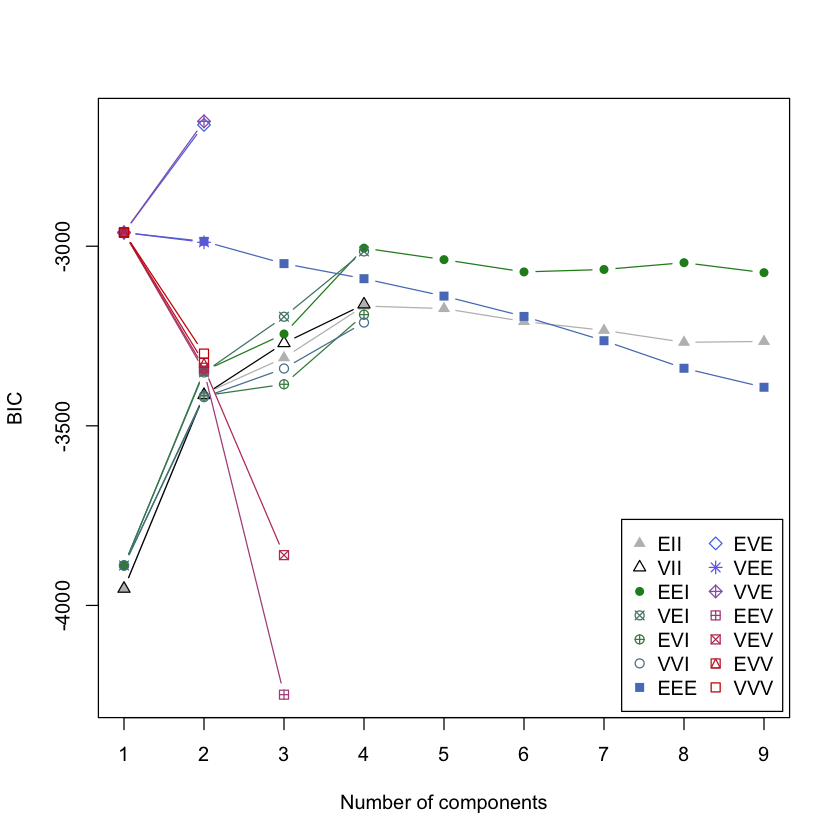

In [8]:
model = Mclust(sigExprs)
plot(model, sigExprs, what="BIC")

> Models `EEI, EII, VII, VEI, EVE, and VVE` all have a significant information gain from the first to second component. For the `VEE and EEE` models, the information gain slowly decreases, showing that none of the components are really signficant. Models `VVE, EEV, VEV,EVV, and VVV` show immediate drip in information gains, indicating that they are not very good models.

## Assignment 7 Exercise 2C

Now, standardize the gene expressions for each gene separately by unit variance scaling: ̅, where ̅ is the mean of a gene expression across all patients and is
the standard deviation. Again, perform GMM based clustering using the standardized values for i) patients and ii) genes and report the optimal number of clusters and mixing proportions.
Perform plots of the BIC criterion, and display the classification of data points resulting from the best model (for both, i) and ii)).
(6 points + 2 bonus points)

In [9]:
sigExprScaled = data.frame(apply(sigExprs, 2, scale))
rownames(sigExprScaled) = rownames(sigExprs)

## Assignment 7 Exercise 2D

Comparing the clusterings of b) and c). Do you observe large differences in the clusterings for either the patient or the gene clustering? Give reasons why or why not the data should be standardized. (4 points +1 bonus point)

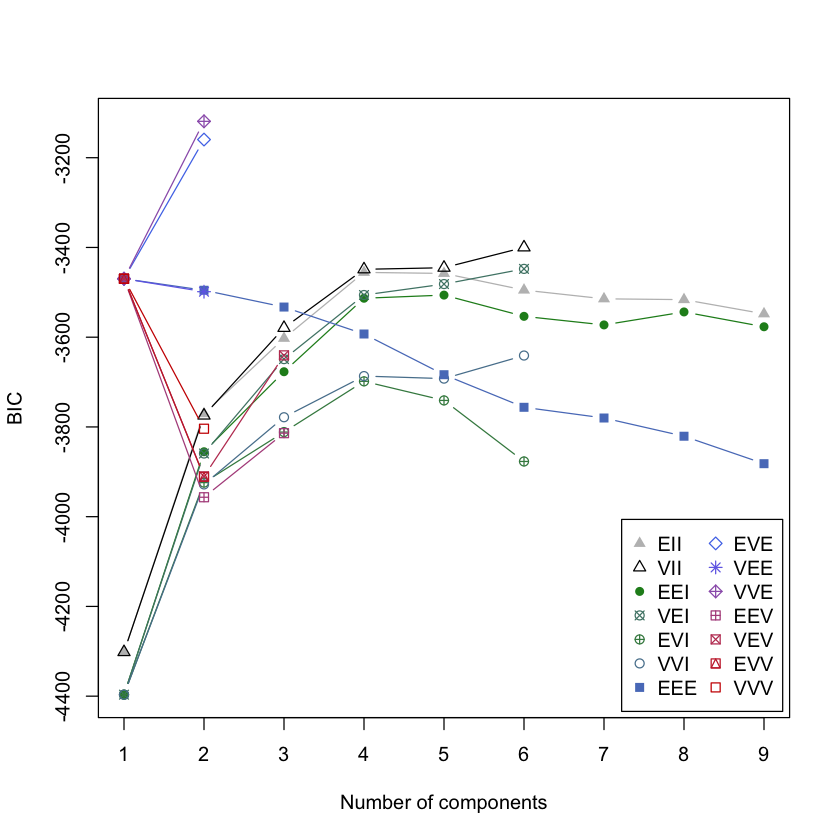

In [10]:
model = Mclust(sigExprScaled)
d = dist(sigExprScaled)
plot(model, sigExprScaled, what="BIC")

> There are not very significant differences. Unlike K-means clustering, GMM is able to handle unscaled data.

## Assignment 7 Exercise 2E

Now consider only the patient clustering (of either b) or c)) and the known grouping into normal and cancer patients. Plot the cluster silhouettes and interpret the result. (3 points + 1 bonus point)

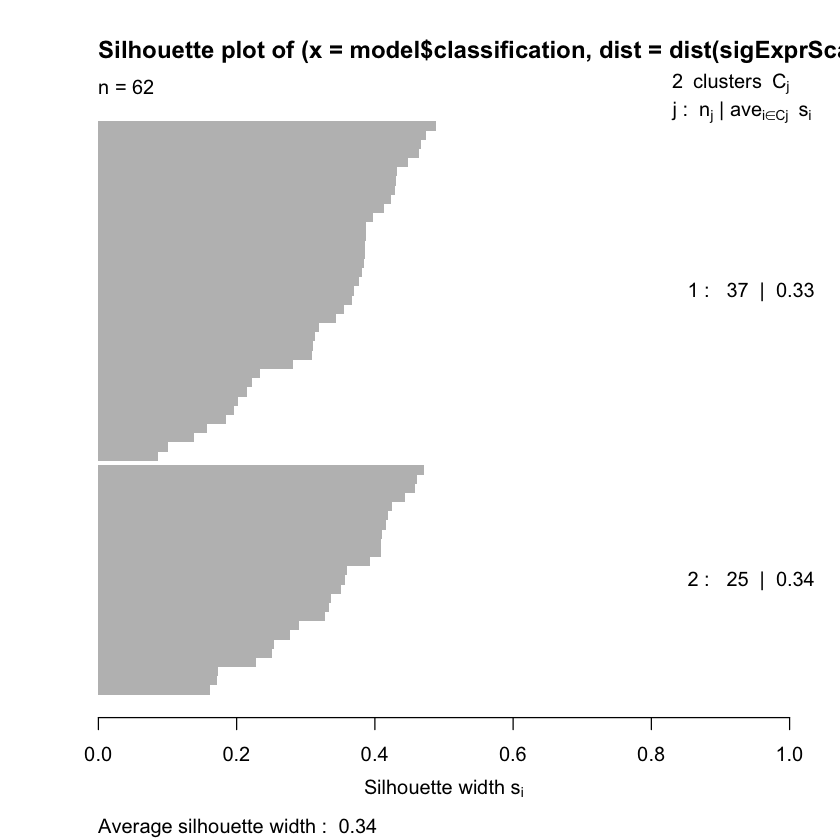

In [11]:
plot(silhouette(model$classification, dist(sigExprScaled)))

> The silhouette plot shows that no points are closer to other clusters than their own. It means that this clustering is high quality and is meaningful. In this case, each cluster should correspond to diseased/healthy state

# Assignment 8 Exercise 1

Install the package [ConsensusClusterPlus](https://www.bioconductor.org/packages/release/bioc/html/ConsensusClusterPlus.html) from Bioconductor and install the [GSVAdata](http://www.bioconductor.org/packages//2.10/data/experiment/html/GSVAdata.html) library from Bioconductor and get the gbm_eset expression data from gbm_VerhaakEtAl.

In [12]:
#biocLite('GSVAdata')

In [13]:
#biocLite('ConsensusClusterPlus')

In [14]:
library('GSVAdata')
library('ConsensusClusterPlus')

Loading required package: GSEABase
Loading required package: annotate
Loading required package: AnnotationDbi
Loading required package: stats4
Loading required package: IRanges
Loading required package: S4Vectors

Attaching package: ‘S4Vectors’

The following objects are masked from ‘package:base’:

    colMeans, colSums, expand.grid, rowMeans, rowSums

Loading required package: XML
Loading required package: graph

Attaching package: ‘graph’

The following object is masked from ‘package:XML’:

    addNode

Loading required package: hgu95a.db
Loading required package: org.Hs.eg.db




In [15]:
data(gbm_VerhaakEtAl)

## Assignment Exerise 1A

Prioritize the gene expressions based on their median absolute deviation (MAD) and select the 2000 genes showing the highest deviation to be used in the following. (2 points + 1 bonus point)

In [16]:
expression = exprs(gbm_eset)
phenotype = pData(gbm_eset)

In [17]:
expression_mads = apply(expression, 1, mad)
head(expression_mads)

AACS     FSTL1     ELMO2   CREB3L1     RPS11     PNMA1 
0.3613541 0.7277639 0.3969661 0.5635511 0.4542390 0.5553227

Calculate sorting based on the MAD, which can be sliced to the proper length and used to reindex the original matrix

In [18]:
expression_perm = order(expression_mads, decreasing=TRUE)

head(expression_mads[expression_perm])

POSTN      LTF    TMSL8      DCX     EGFR    MEOX2 
3.920721 3.101525 2.889899 2.763166 2.602437 2.384555

In [19]:
expression_cut = expression[expression_perm[1:2000],]

## Assignment Exerise 1B

Perform consensus clustering of the samples using 80% item resampling, 80% gene resampling, a maximum number of 6 clusters, and a total of 100 resamplings. Generate heatmaps of the consensus matrices. Can you deduce something about the quality of the clusterings? (3 points + 1 bonus point).

end fraction
clustered
clustered


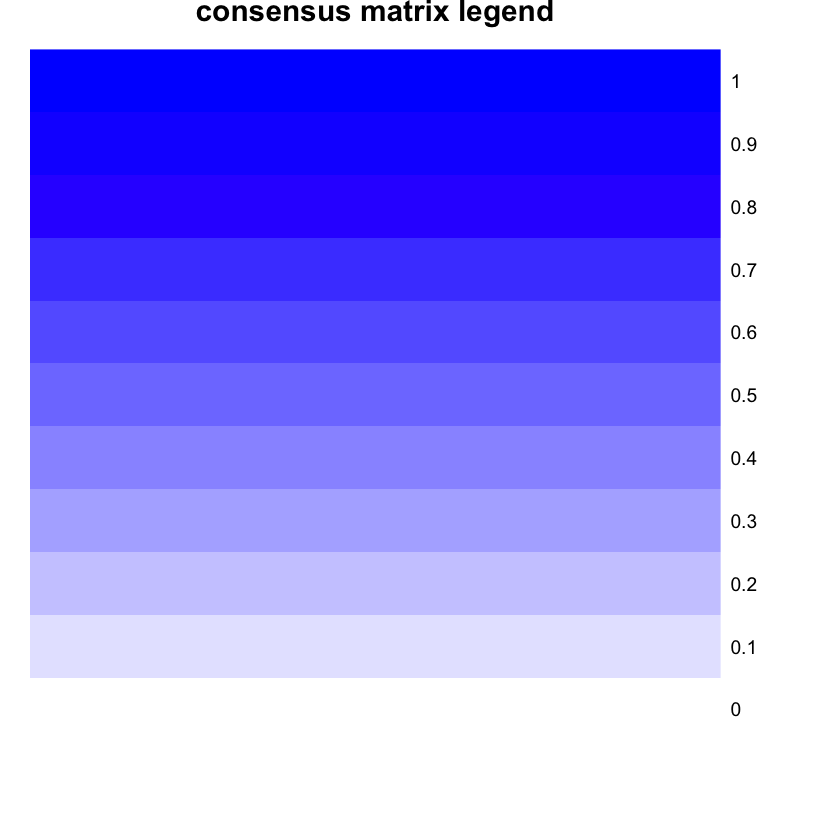

clustered


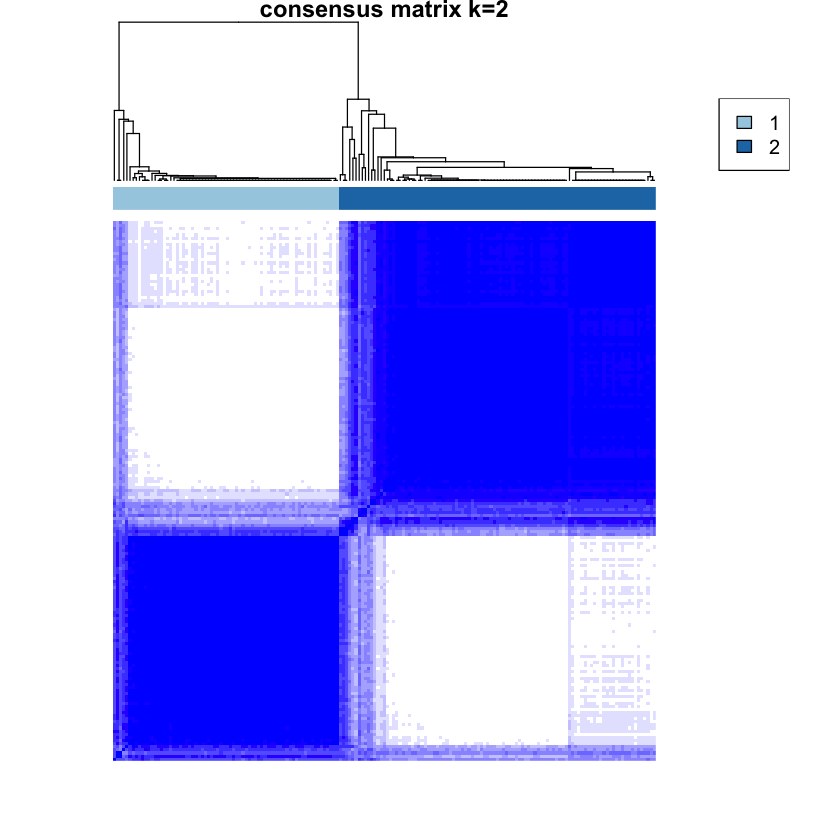

clustered


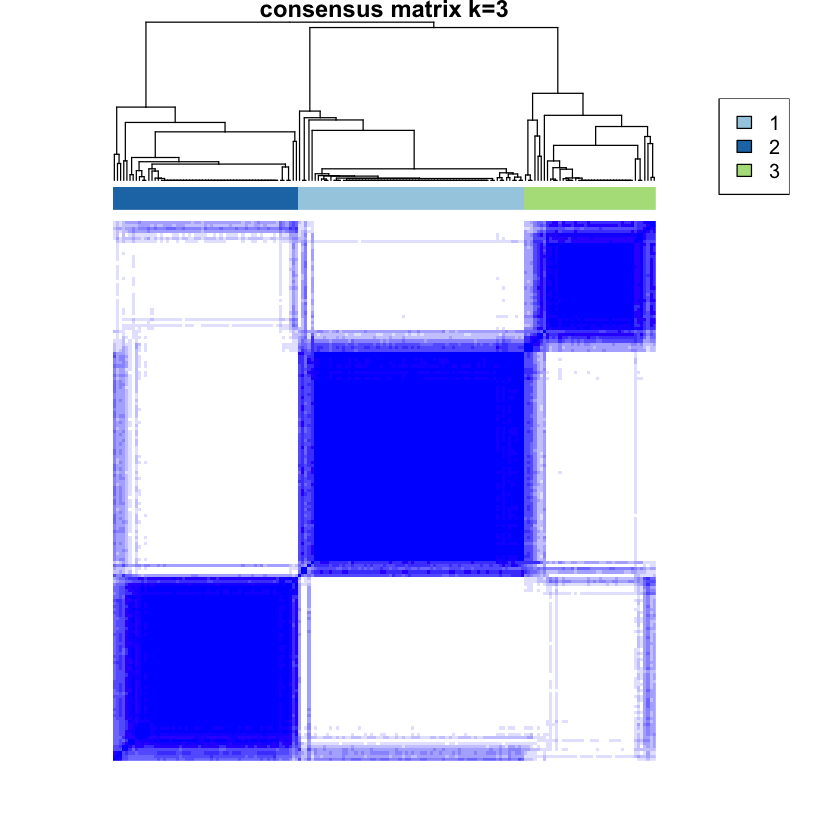

clustered


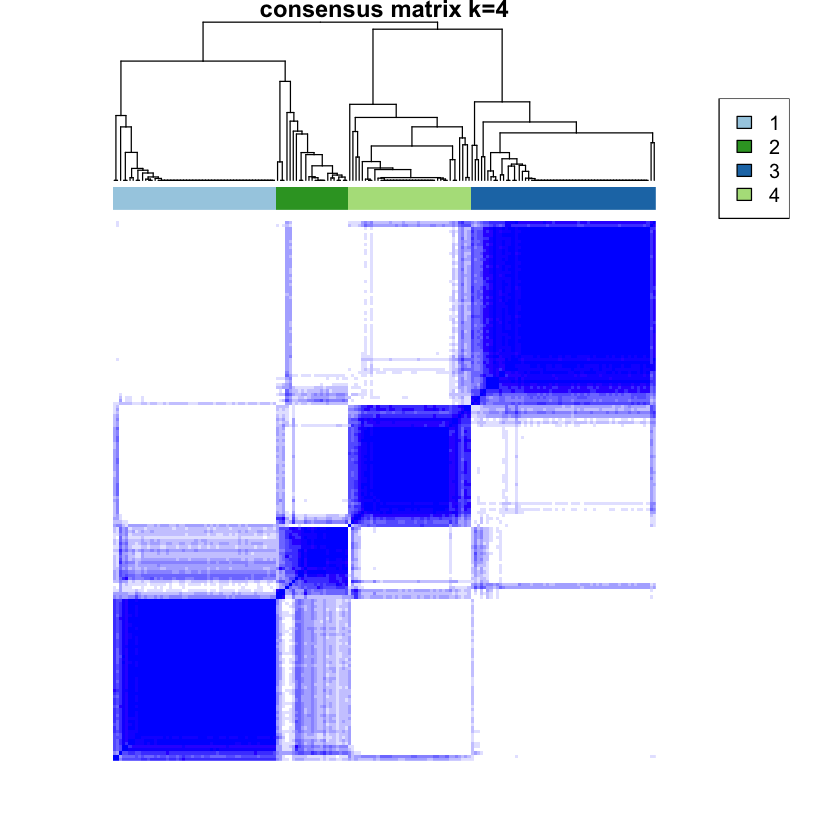

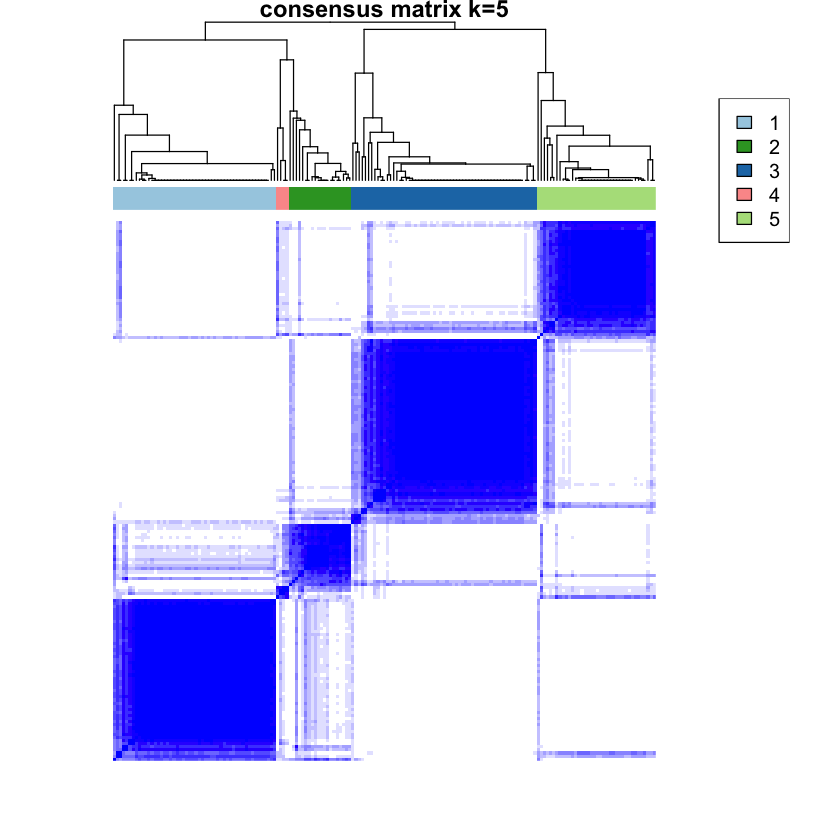

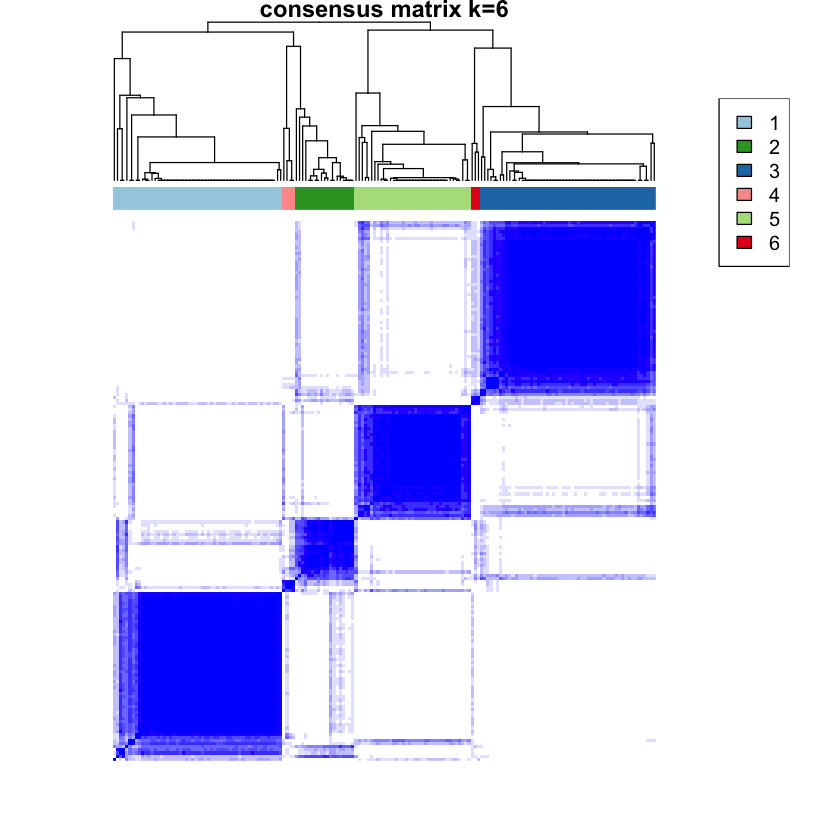

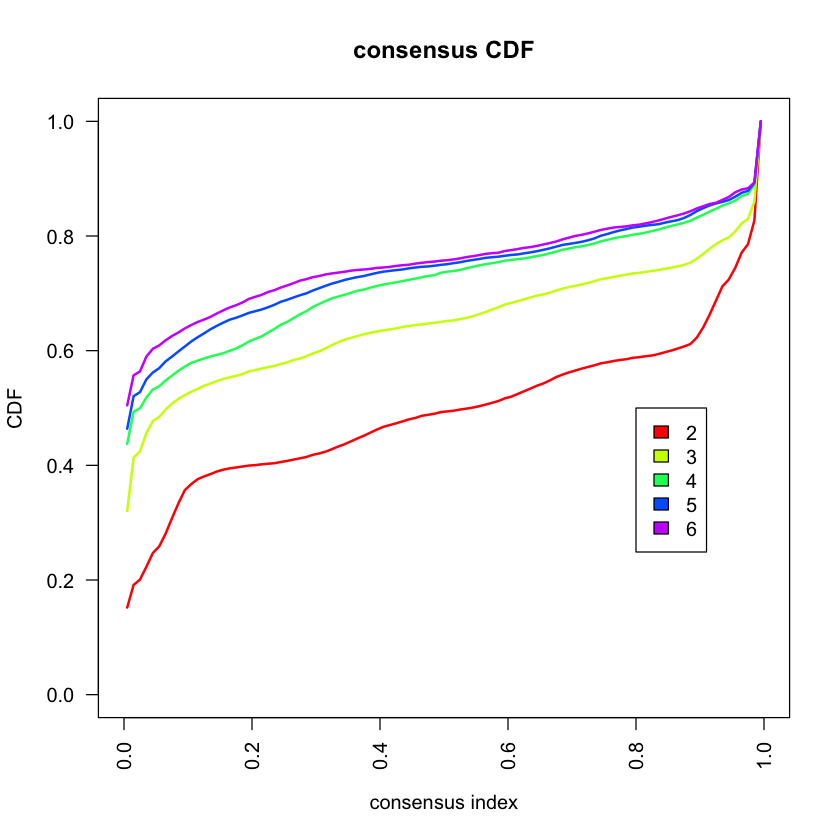

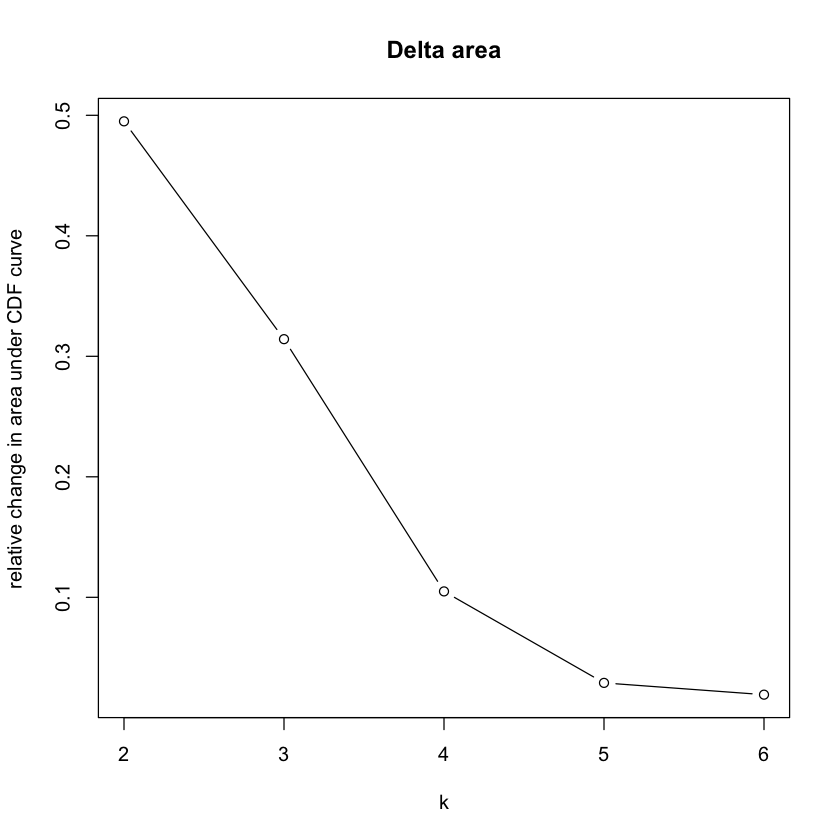

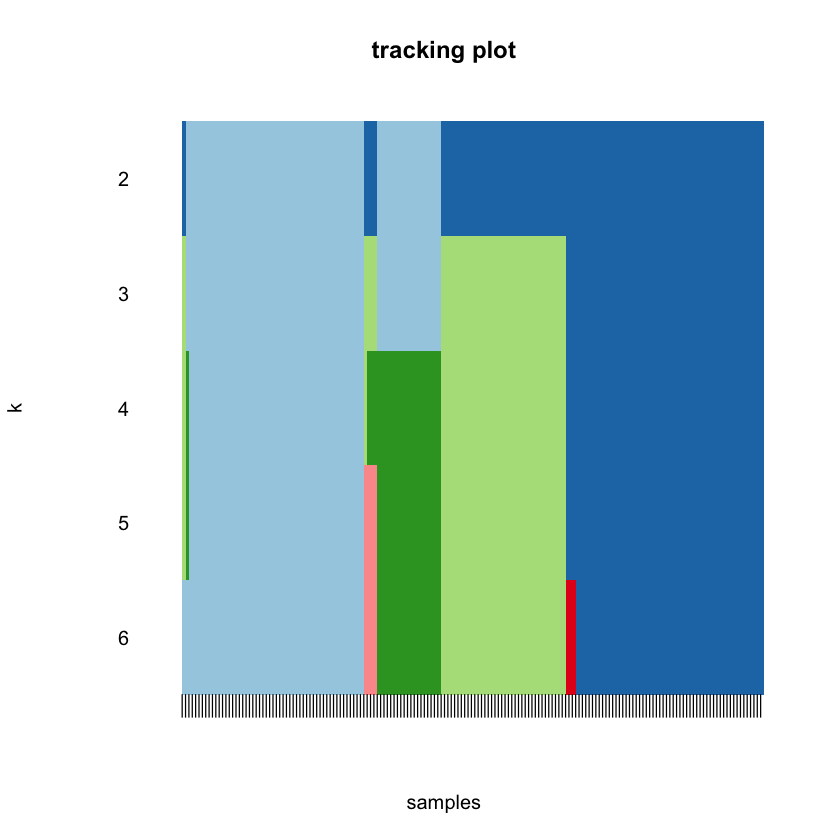

In [20]:
#par(mfrow=c(1,3))
results = ConsensusClusterPlus(expression_cut, 
                               maxK=6,
                               reps=100,
                               pItem=0.8,
                               pFeature=1,
                               clusterAlg="hc",
                               distance="pearson",
                               seed=127,)

> From these analyses, it seems like k=4 is the most appropriate model. This might identify disease subtypes. The quality can be analyzed by examining how white the backgrounds are outside the clusters - this means that there were no trials when these items were in the same cluster. The sihlouette plot indirectly measures this as well.

## Assignment Exerise 1C

Show and interpret plots for the i) cluster consensus and ii) item consensus. (3 points + 1 bonus point)

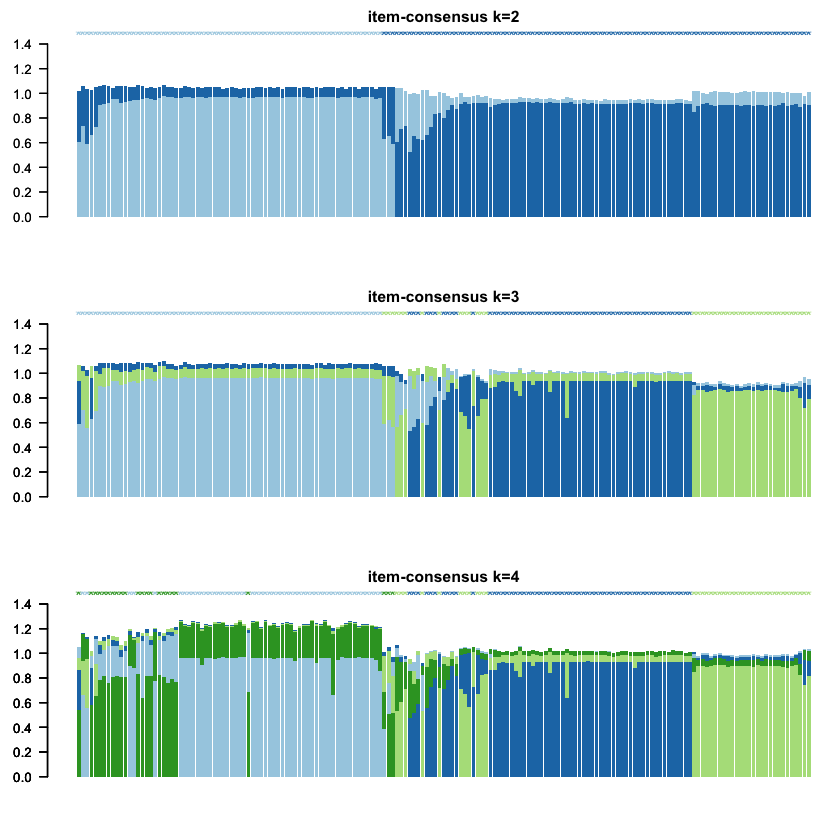

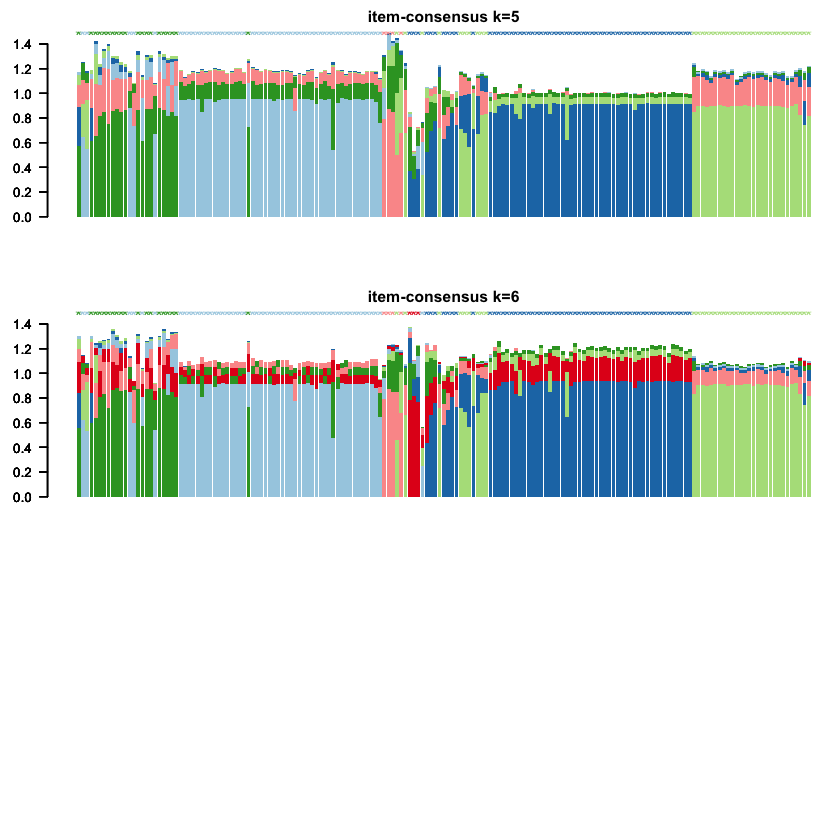

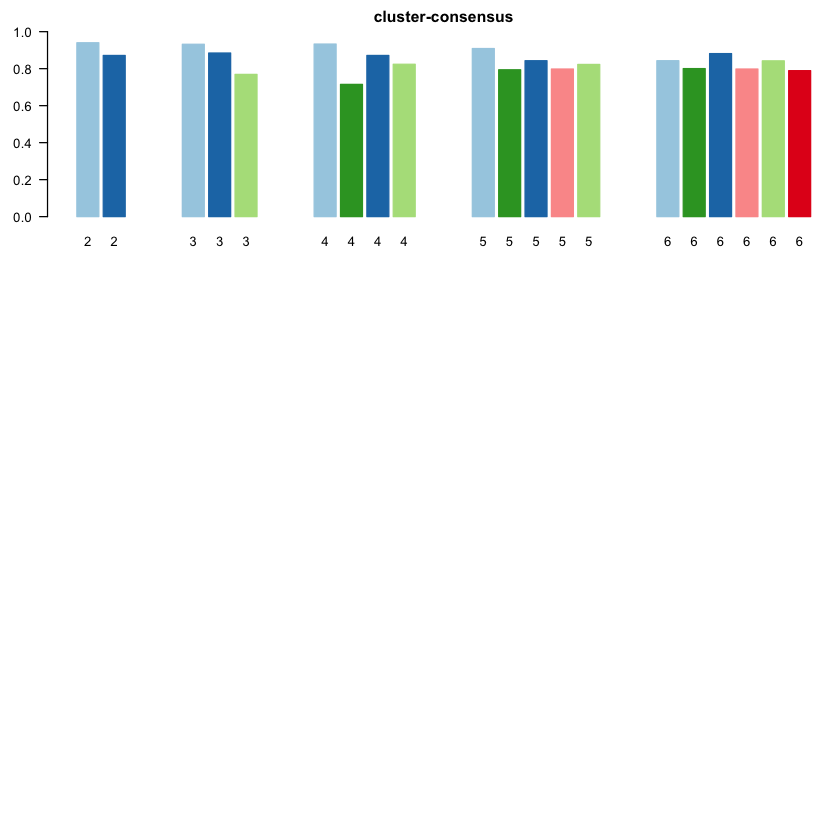

In [21]:
icl = calcICL(results)

> The item concensus plots are effectively the same as a sihlouette plot. At k=2, items belong to the same cluster often match only with the same, showing k=2 is good. With k=3, 5, and 6, items frequently match with other groups. Optimally, k=4 shows good specificity.
>
> The cluster concensus analyzes cluster stability. The higher values are more stable overall. This plot indicates k=2 is the best.  

## Assignment Exerise 1D

Show the empirical cumulative distribution curves (empirical CDF) for two to six clusters. How can you use these curves to determine a good number of clusters? Make a sketch how an ideal empirical CDF would look like. (3 points + 1 bonus point).

> Above, the CDF allows for the identification of the best K when the AUC increase slows. These CDF's also indicate K=4 is the best.

# Assignment 8 Exercise 2

Make sure that the [NMF package](https://cran.r-project.org/web/packages/NMF/index.html) for non-negative matrix factorization is installed. The GSVAdata also contains some leukemia data. Get the leukemia_eset of gene expressions.

In [1]:
library('NMF')
library('pheatmap')
library('GSVAdata')

Loading required package: pkgmaker
Loading required package: registry

Attaching package: ‘pkgmaker’

The following object is masked from ‘package:base’:

    isNamespaceLoaded

Loading required package: rngtools
Loading required package: cluster
NMF - BioConductor layer [OK] | Shared memory capabilities [NO: bigmemory] | Cores 7/8
  To enable shared memory capabilities, try: install.extras('
NMF
')
Loading required package: GSEABase
Loading required package: annotate
Loading required package: AnnotationDbi
Loading required package: stats4
Loading required package: IRanges
Loading required package: S4Vectors

Attaching package: ‘S4Vectors’

The following objects are masked from ‘package:NMF’:

    compare, nrun

The following object is masked from ‘package:pkgmaker’:

    new2

The following objects are masked from ‘package:base’:

    colMeans, colSums, expand.grid, rowMeans, rowSums

Loading required package: XML
Loading required package: graph

Attaching package: ‘graph’

The follow

In [2]:
data(leukemia)
leukemia_eset

ExpressionSet (storageMode: lockedEnvironment)
assayData: 12626 features, 37 samples 
  element names: exprs 
protocolData
  sampleNames: CL2001011101AA.CEL CL2001011102AA.CEL ...
    CL2001011152AA.CEL (37 total)
  varLabels: ScanDate
  varMetadata: labelDescription
phenoData
  sampleNames: CL2001011101AA.CEL CL2001011102AA.CEL ...
    CL2001011152AA.CEL (37 total)
  varLabels: subtype
  varMetadata: labelDescription channel
featureData: none
experimentData: use 'experimentData(object)'
Annotation: hgu95a 

## Assignment 8 Exercise 2A

Prioritize the gene expressions based on their median absolute deviation (MAD) and select the 2000 genes showing the highest deviation to be used in the following . (1 point)

In [3]:
expr = exprs(leukemia_eset)
mads = apply(expr, 1, mad)
o = order(mads, decreasing=TRUE)[1:2000]
top2000 = expr[o,]

## Assignment 8 Exercise 2B

Perform a non-negative matrix factorizations (NMF) of rank 2 and 3 using the Brunet method with 50 repetitions. Plot heatmaps of the coefficients and consensus matrices and interpret the result. (6 points + 2 bonus points)

In [4]:
nout = nmf(top2000, rank=2, method=nmfAlgorithm("brunet"), nrun=10)
nout

<Object of class: NMFfitX1 >
  Method: brunet 
  Runs:  10 
  RNG:
   407L, 350016430L, -1086105513L, -322885460L, -1905635907L, -1093674662L, 869572371L 
  Total timing:
   user  system elapsed 
 21.074   2.086   6.478 

In [ ]:
par(mfrow = c(1, 2))
coefmap(nout)

<img src='files/s1.png' />

The NMF package has a current error on GitHub with parallel computing so it was timing out, and couldn't compute multiple runs. They also updated R to 3.3.1 which could have caused more issues. These two plots don't mean much without having multiple runs to compare - since it's investigating the effect of the random starting state on the results and seeing if there's a concensus. 

The coefficient matrix already shows two obvious clusters in the data, but the concensus map is pretty much useless in this state. If it was working properly, this plot would allow interpretation the same way the concensus clustering heirarchical clustering plot would

In [ ]:
consensusmap(nout)

<img src='files/s2.png'>

